In [2]:
#LIBRARIES
#%%
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.cm as cm
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.base import BaseEstimator
from sklearn.neighbors import LocalOutlierFactor
from sklearn.feature_selection import VarianceThreshold
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
from sklearn import metrics
from sklearn import datasets

#%%

# DATASET 
Export of our playlists from Spotify using the Spotify Developer API

In [3]:

all_feats = pd.read_csv('https://raw.githubusercontent.com/ie-mcsbt-team-c/spotify-clustering/master/TEAM_C_SPOTIFY.csv',';')


Decision to choose this dataset for the Clustering Assignment

In [4]:
#The Dataset consist of the last 50 songs listened on Spotify extracted thanks to the Spotify API from several users.
#The Data contains 228 lignes and 11 features in total. 
#7 of those features/variables are used to describe the music : Energy, Liveness, Speechiness, 
#Acousticness, Instrumentalness, Danceability and Valence. 

all_feats.head(5)

,Unnamed: 0,energy,liveness,speechiness,acousticness,instrumentalness,danceability,valence,uri,song_names,artist
0,0,0.543,0.5950,0.0468,0.1440,0.848000,0.413,0.709,spotify:track:26qIVWus5hMZUcWeJUxeJx,August Twelve,Khruangbin
1,1,0.757,0.0859,0.0380,0.1280,0.485000,0.659,0.553,spotify:track:5wQ4WwvlMMk0B7EKL5RBOM,Gamesofluck,Parcels
2,2,0.835,0.6690,0.0701,0.0250,0.002430,0.512,0.242,spotify:track:2OPmeyf31LlcIpYcJ4aegt,Safe and Sound (WWW),Justice
3,3,0.782,0.6720,0.0323,0.0613,0.000003,0.580,0.274,spotify:track:0LpnNgvF6z5HJYAgLClfMB,D.A.N.C.E. (WWW),Justice
4,4,0.921,0.4260,0.0996,0.0124,0.001310,0.555,0.217,spotify:track:50fkJxrv0ZLTt9EHZGBOP7,Canon x Love S.O.S. (WWW),Justice


In [5]:
 #The below table contains all the audiofeatures which are exclusively integer datatype.
all_feats.select_dtypes(include= 'number').head(5)

,Unnamed: 0,energy,liveness,speechiness,acousticness,instrumentalness,danceability,valence
0,0,0.543,0.5950,0.0468,0.1440,0.848000,0.413,0.709
1,1,0.757,0.0859,0.0380,0.1280,0.485000,0.659,0.553
2,2,0.835,0.6690,0.0701,0.0250,0.002430,0.512,0.242
3,3,0.782,0.6720,0.0323,0.0613,0.000003,0.580,0.274
4,4,0.921,0.4260,0.0996,0.0124,0.001310,0.555,0.217


# EXPLORATION

In [6]:
all_feats.describe() 

,Unnamed: 0,energy,liveness,speechiness,acousticness,instrumentalness,danceability,valence
count,228.000000,228.000000,228.000000,228.000000,228.000000,228.000000,228.000000,228.000000
mean,21.828947,0.587905,0.251358,0.070827,0.358719,0.222477,0.566100,0.434125
std,14.116933,0.247675,0.268804,0.054445,0.327044,0.354656,0.184722,0.266604
min,0.000000,0.004550,0.021900,0.025800,0.000062,0.000000,0.076700,0.035800
25%,9.750000,0.443000,0.098425,0.039250,0.060650,0.000003,0.440750,0.213750
50%,21.000000,0.659000,0.122500,0.050100,0.271000,0.000878,0.592500,0.394500
75%,33.250000,0.772000,0.277500,0.078800,0.638250,0.479000,0.697000,0.657750
max,49.000000,0.945000,0.981000,0.388000,0.996000,0.976000,0.909000,0.966000


Histogram plots for visualizing the distribution of each feature

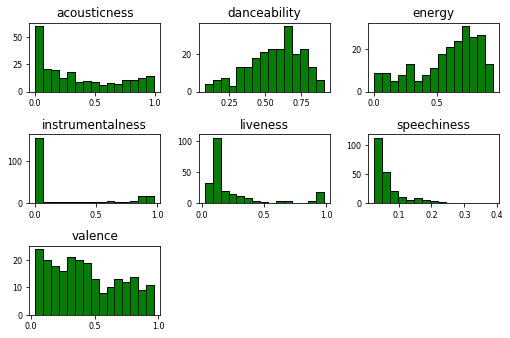

In [7]:
#Visualizing data in One Dimension (1-D) thanks to histogram. Here, we are 
# only concerned with analyzing one data attribute or variable and visualizing the same (one dimension)

all_feats = all_feats.drop("Unnamed: 0", axis = 1)

all_feats.hist(bins=15, color='green', edgecolor='black', linewidth=1.0,
           xlabelsize=8, ylabelsize=8, grid=False)    
plt.tight_layout(rect=(0, 0, 1.2, 1.2))    

#Conclusion: The plots give a good idea of data distribution of each feature.
#We can see that all values are between 0 and 1.
#N.B : We were surprise with Speechiness but it compared to Podcast (Value of 1). 


Exploration of correlation between audiofeatures

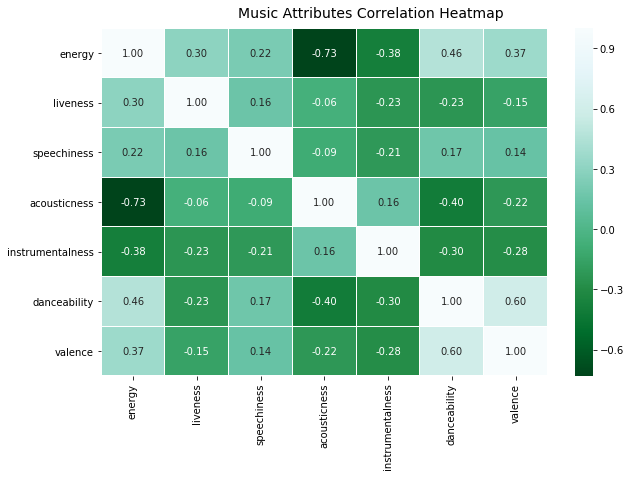

In [8]:
#Visualizing data in Two Dimensions (2-D):  Let's now check out potential relationships 
# or correlations amongst the different data attributes

# The pair-wise Correlation Matrix Heatmap

f, ax = plt.subplots(figsize=(10, 6))
corr = all_feats.corr()
hm = sns.heatmap(round(corr,2), annot=True, ax=ax, cmap="BuGn_r",fmt='.2f',
                 linewidths=.05)
f.subplots_adjust(top=0.93)
t= f.suptitle('Music Attributes Correlation Heatmap', fontsize=14)

#Conclusion : Acoustiness and Energy seems to be negatively correlated. 
            #Danceability and Valence seems to be positively correlated 

Acoustiness and Energy seem to be negatively correlated 



# CLEANING

In [9]:
#We are dropping the non-integer type variables
audiofeats = all_feats.drop(['uri','artist','song_names'], axis=1)

#We are dropping the acousticness variable because it is negatively correlated with energy
audiofeats = audiofeats.drop('acousticness', axis=1)

#We convert the dataset into a numpy array in order to perform scaling.

#Although all of the variables were btw 0 and 1, we can see that some of the features are very low, 
#like Speechiness (Mean of 0.07).
#In this situation leaving the dataset unscaled is equivalent to putting less weight on Speechiness.

audio_array = np.array(audiofeats)

#Scale : Transforms features by scaling each feature to a given range.

mms = MinMaxScaler()
mms.fit(audio_array)
audio_array_scaled = mms.transform(audio_array)

# CLUSTERING

Using clustering algorithms to uncover patterns in the data

1. Finding the number of clusters

A. Elbow method

{'Number of cluster': 1}
{'Model Inertia Value': 98.50617668135888}
{'Number of cluster': 2}
{'Model Inertia Value': 64.7197832804556}
{'Number of cluster': 3}
{'Model Inertia Value': 47.56794756305696}
{'Number of cluster': 4}
{'Model Inertia Value': 37.65743340316908}
{'Number of cluster': 5}
{'Model Inertia Value': 28.034624991811086}
{'Number of cluster': 6}
{'Model Inertia Value': 25.31623124109854}
{'Number of cluster': 7}
{'Model Inertia Value': 23.387358818570892}
{'Number of cluster': 8}
{'Model Inertia Value': 21.60550700974086}
{'Number of cluster': 9}
{'Model Inertia Value': 19.69750159644431}


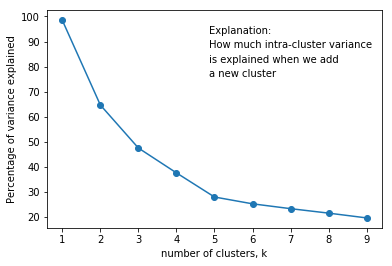

In [10]:
#If you graph the percentage of variance explained by 
#the clusters against the number of clusters, the first clusters will 
#add much information (explain a lot of variance), but at some point 
#the marginal gain will drop, giving an angle in the graph. 
#The number of clusters are chosen at this point, hence the “elbow criterion”.

ks = range(1, 10)
inertias = []

def number_of_clusters():
    
    for k in ks:
        model = KMeans(n_clusters=k, random_state=None)
        model.fit(audio_array_scaled)
        inertias.append(model.inertia_)
        print({"Number of cluster":k})
        print({"Model Inertia Value":model.inertia_})
        
number_of_clusters()

plt.plot(ks, inertias, '-o')
plt.xlabel('number of clusters, k')
plt.ylabel('Percentage of variance explained')
plt.figtext(.5, .8, "Explanation:")
plt.figtext(.5, .75, "How much intra-cluster variance")
plt.figtext(.5, .7, "is explained when we add")
plt.figtext(.5, .65, "a new cluster")
plt.xticks(ks)
plt.show()

#Inertia refers to within-cluster sum-of-squares of all clusters. 
#Then show how well packed the clusters. 
 


We can see there is no a significant different after 5 clusters. The Elbow method suggests that 5 is the optimal number of clusters.

B. Silhouette Analysis

For n_clusters = 4 The average silhouette_score is : 0.39618221559391803
For n_clusters = 5 The average silhouette_score is : 0.3688267499429346
For n_clusters = 6 The average silhouette_score is : 0.34366264241003364


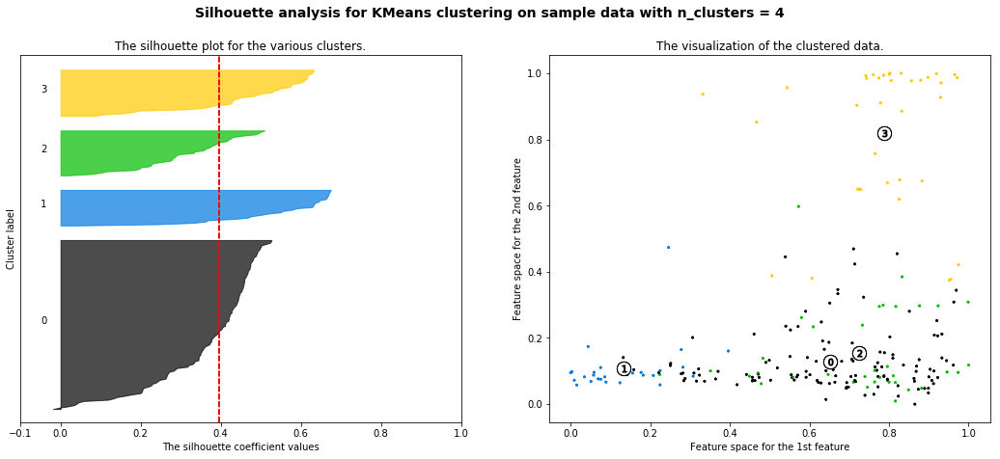

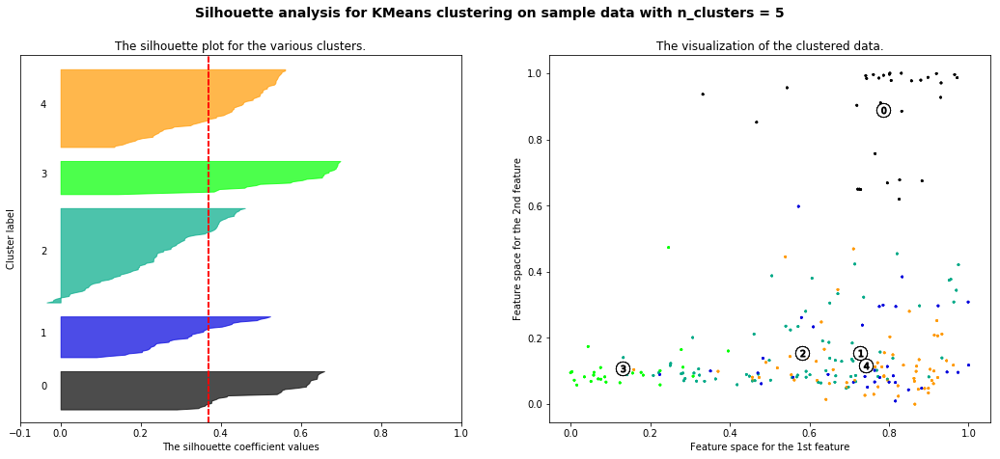

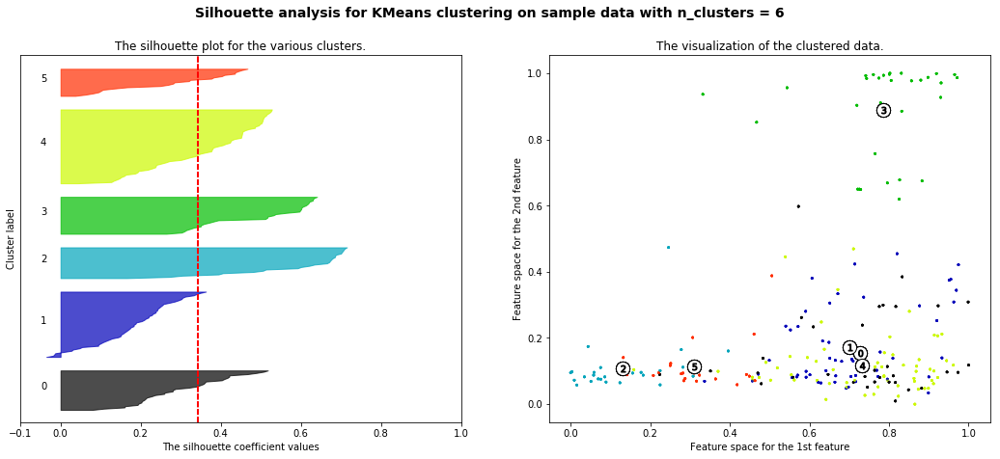

In [11]:
#Silhouette coefficients near +1 indicate that the sample is far away from the
#neighboring clusters. A value of 0 indicates that the sample is on or very close to the decision 
#boundary between two neighboring clusters and negative values indicate that those samples 
#might have been assigned to the wrong cluster.
#
#Avg Silhouette score: I get the average Silhouette score of the cluster k.
#Silhouette samples score: And, for all the samples belonging to a given cluster 
#(from 1 to k), I calculate the individual silhouette score of each sample belong 
#to that cluster.

# Important #

#Negative values means that they are not in the right cluster since they might
#be closer to other centroids from other clusters. 

#Then I sort the scores of all samples belonging to each cluster. 
#This is needed so that I can plot the score in an ascending order.

#s(i) = {b(i) - a(i)} / {\max\{a(i),b(i)\}}
#


#Explnation here https://www.youtube.com/watch?v=5TPldC_dC0s


range_n_clusters = [4,5,6]
scores=[]

def number_of_clusters_silhouette():
        
    for n_clusters in range_n_clusters:
        # Create a subplot with 1 row and 2 columns
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)
         
        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(audio_array_scaled) + (n_clusters + 1) * 10])
        
        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        clusterer = KMeans(n_clusters=n_clusters, random_state=10)
        cluster_labels = clusterer.fit_predict(audio_array_scaled)
        
        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(audio_array_scaled, cluster_labels)
        scores.append(silhouette_avg)
        print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)
#        
        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(audio_array_scaled, cluster_labels)
        
#        If you want to see the values for each point of the dataset
#        print(sample_silhouette_values)
        
        y_lower = 10
        
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = \
                sample_silhouette_values[cluster_labels == i]
#    
            ith_cluster_silhouette_values.sort()
#    
            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i
#    
            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)
    
            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    
            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples
    
            ax1.set_title("The silhouette plot for the various clusters.")
            ax1.set_xlabel("The silhouette coefficient values")
            ax1.set_ylabel("Cluster label")
        
            # The vertical line for average silhouette score of all the values
            ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
        
            ax1.set_yticks([])  # Clear the yaxis labels / ticks
            ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
        
            # 2nd Plot showing the actual clusters formed
            colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
            ax2.scatter(audio_array_scaled[:, 0], audio_array_scaled[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                        c=colors, edgecolor='k')
        
            # Labeling the clusters
            centers = clusterer.cluster_centers_
            # Draw white circles at cluster centers
            ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                        c="white", alpha=1, s=200, edgecolor='k')
        
        for i, c in enumerate(centers):
            ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                        s=50, edgecolor='k')
    
            ax2.set_title("The visualization of the clustered data.")
            ax2.set_xlabel("Feature space for the 1st feature")
            ax2.set_ylabel("Feature space for the 2nd feature")
    
            plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                      "with n_clusters = %d" % n_clusters),
                     fontsize=14, fontweight='bold')
        
number_of_clusters_silhouette()

2. Running K-means and avoiding different seed, local minimum and convergence

In [12]:
def clustering_centers_A():
    model = KMeans(n_clusters=5, init="k-means++", n_init=228, precompute_distances = True, random_state=50, max_iter=300).fit(audio_array_scaled)
    labels = model.fit_predict(audio_array_scaled)


    model.cluster_centers_
    centers = np.array(model.cluster_centers_)
    counter = len(centers)
    i = 0
    for r in range(counter):
        i+=1
        if i <= counter: 
            print ({"The center of cluster "+str(r):centers[r]})
    
            
clustering_centers_A()

{'The center of cluster 0': array([0.74157876, 0.1181299 , 0.14077501, 0.02350703, 0.75906253,
       0.78185406])}
{'The center of cluster 1': array([0.13045528, 0.10900651, 0.04695585, 0.8391014 , 0.20500087,
       0.11623148])}
{'The center of cluster 2': array([0.78524351, 0.88833618, 0.18239789, 0.00399121, 0.4522369 ,
       0.33517592])}
{'The center of cluster 3': array([0.72824099, 0.15342351, 0.09694125, 0.78250745, 0.69030689,
       0.42039509])}
{'The center of cluster 4': array([0.58069718, 0.15571682, 0.12659304, 0.02549765, 0.59559454,
       0.29008099])}


In [13]:
def clustering_centers_B():
    model = KMeans(n_clusters=5, init="k-means++", n_init=228, precompute_distances = True, random_state=20, max_iter=300).fit(audio_array_scaled)
    labels = model.fit_predict(audio_array_scaled)


    model.cluster_centers_
    centers = np.array(model.cluster_centers_)
    counter = len(centers)
    i = 0
    for r in range(counter):
        i+=1
        if i <= counter: 
            print ({"The center of cluster "+str(r):centers[r]})
            

clustering_centers_B()

{'The center of cluster 0': array([0.78524351, 0.88833618, 0.18239789, 0.00399121, 0.4522369 ,
       0.33517592])}
{'The center of cluster 1': array([0.13045528, 0.10900651, 0.04695585, 0.8391014 , 0.20500087,
       0.11623148])}
{'The center of cluster 2': array([0.58069718, 0.15571682, 0.12659304, 0.02549765, 0.59559454,
       0.29008099])}
{'The center of cluster 3': array([0.74157876, 0.1181299 , 0.14077501, 0.02350703, 0.75906253,
       0.78185406])}
{'The center of cluster 4': array([0.72824099, 0.15342351, 0.09694125, 0.78250745, 0.69030689,
       0.42039509])}


In [14]:
def clustering_centers_C():
    model = KMeans(n_clusters=5, init="k-means++", n_init=228, precompute_distances = True, random_state=100, max_iter=300).fit(audio_array_scaled)
    labels = model.fit_predict(audio_array_scaled)


    model.cluster_centers_
    centers = np.array(model.cluster_centers_)
    counter = len(centers)
    i = 0
    for r in range(counter):
        i+=1
        if i <= counter: 
            print ({"The center of cluster "+str(r):centers[r]})
    
       
clustering_centers_C()

{'The center of cluster 0': array([0.74157876, 0.1181299 , 0.14077501, 0.02350703, 0.75906253,
       0.78185406])}
{'The center of cluster 1': array([0.72824099, 0.15342351, 0.09694125, 0.78250745, 0.69030689,
       0.42039509])}
{'The center of cluster 2': array([0.78524351, 0.88833618, 0.18239789, 0.00399121, 0.4522369 ,
       0.33517592])}
{'The center of cluster 3': array([0.13045528, 0.10900651, 0.04695585, 0.8391014 , 0.20500087,
       0.11623148])}
{'The center of cluster 4': array([0.58069718, 0.15571682, 0.12659304, 0.02549765, 0.59559454,
       0.29008099])}


In [15]:
def clustering_centers_D():
    model = KMeans(n_clusters=5, init="k-means++", n_init=228, precompute_distances = True, random_state=None, max_iter=300).fit(audio_array_scaled)
#    labels = model.fit_predict(audio_array_scaled)


    model.cluster_centers_
    centers = np.array(model.cluster_centers_)
    counter = len(centers)
    i = 0
    for r in range(counter):
        i+=1
        if i <= counter: 
            print ({"The center of cluster "+str(r):centers[r]})
    
 
clustering_centers_D()

{'The center of cluster 0': array([0.74157876, 0.1181299 , 0.14077501, 0.02350703, 0.75906253,
       0.78185406])}
{'The center of cluster 1': array([0.58069718, 0.15571682, 0.12659304, 0.02549765, 0.59559454,
       0.29008099])}
{'The center of cluster 2': array([0.72824099, 0.15342351, 0.09694125, 0.78250745, 0.69030689,
       0.42039509])}
{'The center of cluster 3': array([0.78524351, 0.88833618, 0.18239789, 0.00399121, 0.4522369 ,
       0.33517592])}
{'The center of cluster 4': array([0.13045528, 0.10900651, 0.04695585, 0.8391014 , 0.20500087,
       0.11623148])}


3. Evaluation of the clustering by the method of Calinsky Harabsz

In [16]:
# Evaluation of clustering

#Calinski-Harabasz Index : The math formula to the measure.

#      (SSB/SSW)×(N−k/k−1)

#Where k is the number of clusters, and N is the total number of observations (data points), 
#SSW is the overall within-cluster variance (equivalent to the total within sum of squares), 
#SSB is the overall between-cluster variance.

#You can calculate SSB by using the total sum of squares (tss) minus SSW. For a given dataset, 
#the total sum of squares (tss) is the squared distance of all the data points from the dataset’s centroid, 
#this measure is independent with the number of cluster.

#For clarity, SSB measures the variance of all the cluster centroids from the dataset’s grand centroid 
#(A big SSB value means that the centroid of each cluster will be spread out and they are not too close to each other), 
#and given that we already know SSW will keep on decreasing as the number of clusters goes up. Therefore, 
#for the Calinski-Harabasz Index, the ratio of SSBSSW should be the biggest that at the optimal clustering size.


In [17]:
def calinski_harabaz_score_4():
    model = KMeans(n_clusters=4, init="k-means++", n_init=228, precompute_distances = True, random_state=None, max_iter=300).fit(audio_array_scaled)
    labels = model.fit_predict(audio_array_scaled)
    print ("The value of calinski_harabaz_score for 4 clusters is = "+ str(metrics.calinski_harabaz_score(audio_array_scaled, labels))) 
    
calinski_harabaz_score_4()

The value of calinski_harabaz_score for 4 clusters is = 120.65009271332397


In [18]:
def calinski_harabaz_score_5():
    model = KMeans(n_clusters=5, init="k-means++", n_init=228, precompute_distances = True, random_state=None, max_iter=300).fit(audio_array_scaled)
    labels = model.fit_predict(audio_array_scaled)
    print ("The value of calinski_harabaz_score for 5 clusters is = "+ str(metrics.calinski_harabaz_score(audio_array_scaled, labels))) 
    
calinski_harabaz_score_5()

The value of calinski_harabaz_score for 5 clusters is = 140.14059427725144


In [19]:
def calinski_harabaz_score_6():
    model = KMeans(n_clusters=6, init="k-means++", n_init=228, precompute_distances = True, random_state=None, max_iter=300).fit(audio_array_scaled)
    labels = model.fit_predict(audio_array_scaled)
    print ("The value of calinski_harabaz_score for 6 clusters is = "+ str(metrics.calinski_harabaz_score(audio_array_scaled, labels))) 

calinski_harabaz_score_6()

The value of calinski_harabaz_score for 6 clusters is = 128.4875509494424


In [20]:
model = KMeans(n_clusters=5, init="k-means++", n_init=10, precompute_distances = True).fit(audio_array_scaled)
labels = model.fit_predict(audio_array_scaled)

# VISUALIZATION

2D Visualization

Text(0.5,0,'instrumentalness')

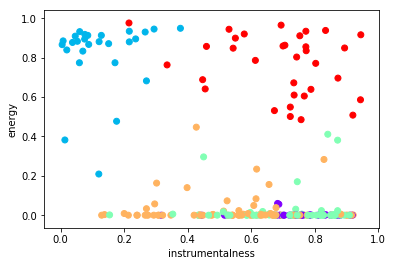

In [21]:
#We can use scatter plot in 2D with colors to visualize the clusters produced by our model
#Our clustering was based on 6 features, however 2D only allows us to plot the data points against 
#2 axes. 
#Picking random variables (energy, instrumentalness) for the x and y axes doesn´t allow us to 
#produce a clear visual representation of the clusters 

plt.scatter(x=audiofeats.energy,y=audiofeats.instrumentalness, c=model.labels_, cmap='rainbow')
plt.ylabel("energy")
plt.xlabel("instrumentalness")

In [22]:
#In order to have a better visual representation we want to choose the variables that explain 
#most of the variance as the x and y axes
#Let´s look at the distribution of the variables amongst the different clusters

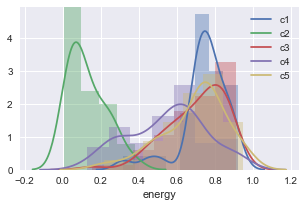

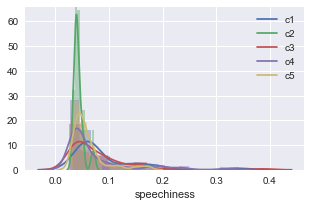

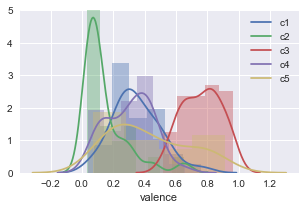

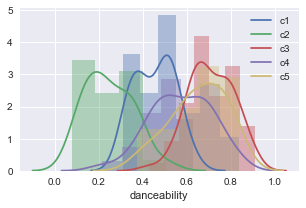

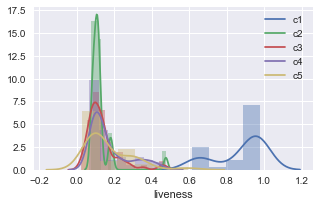

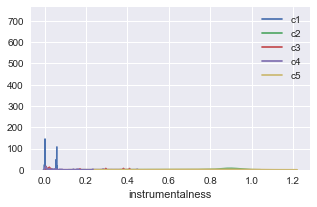

In [23]:
audiofeats['cluster'] = model.labels_

c1= audiofeats.loc[audiofeats['cluster'] == 0]
c2= audiofeats.loc[audiofeats['cluster'] == 1]
c3= audiofeats.loc[audiofeats['cluster'] == 2]
c4= audiofeats.loc[audiofeats['cluster'] == 3]
c5= audiofeats.loc[audiofeats['cluster'] == 4]

import warnings; warnings.simplefilter('ignore')

variables = ["energy","speechiness","valence","danceability","liveness","instrumentalness"]
clusters = {"c1":c1,"c2":c2,"c3":c3,"c4":c4,"c5":c5}

sns.set(rc={'figure.figsize':(5,3)})

for j in variables:

    for i in clusters:
        ax=sns.distplot(clusters[i][j], kde_kws={"label": i})

    plt.show()

Text(0.5,0,'energy')

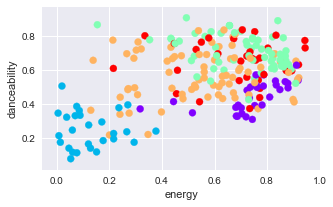

In [24]:
#Energy & Dancability have the greatest variance amongst clusters
#Let´s use scatter plot with these two axes

plt.scatter(x=audiofeats.energy,y=audiofeats.danceability, c=model.labels_, cmap='rainbow')
plt.ylabel("danceability")
plt.xlabel("energy")

3D Visualization

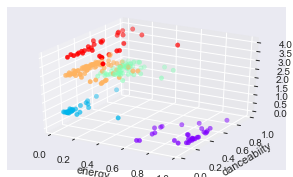

In [25]:
#Plotted against energy and danceability, our clusters appear more clearly. However, valence also 
#appears to have a quite high variance. Let´s to try to plot using 3D.

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

audio_3d = np.array((audiofeats).astype(float))

#

#kmeans = KMeans(n_clusters=4)  
#kmeans.fit(spot1)

sns.set(rc={'figure.figsize':(9,9)})

X = audio_3d[:,1]       #energy
Y = audio_3d[:,5]       #danceability
Z = audio_3d[:,6]       #valence

#ax.scatter(X, Y, Z, c='r', marker='o')
ax.scatter(X, Y, Z, c=model.labels_, cmap='rainbow', marker='o')

ax.set_xlabel('energy')
ax.set_ylabel('danceabiity')
ax.set_zlabel('valence')

plt.show()

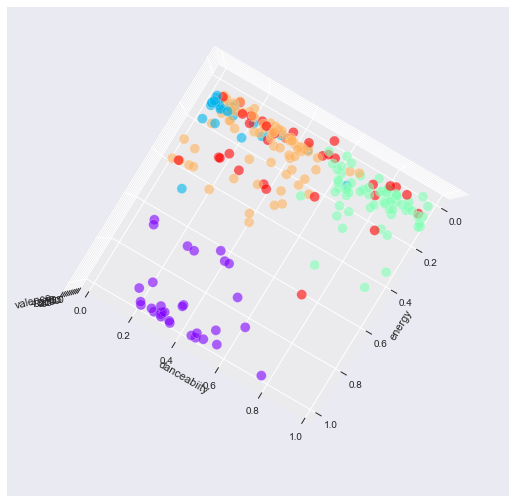

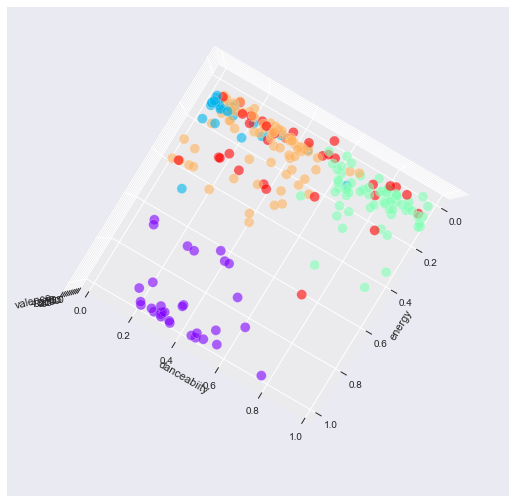

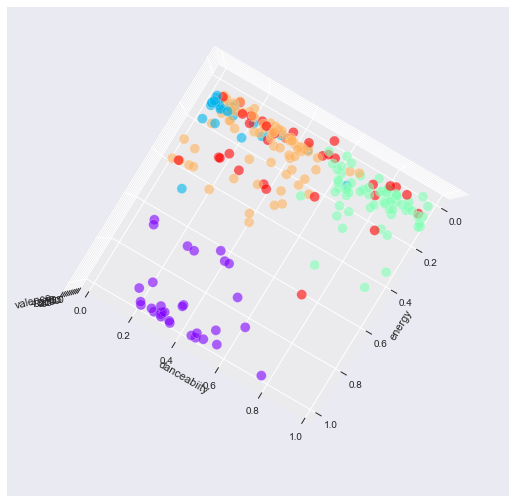

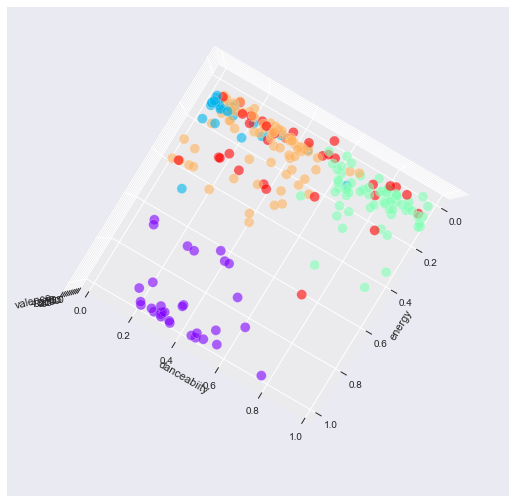

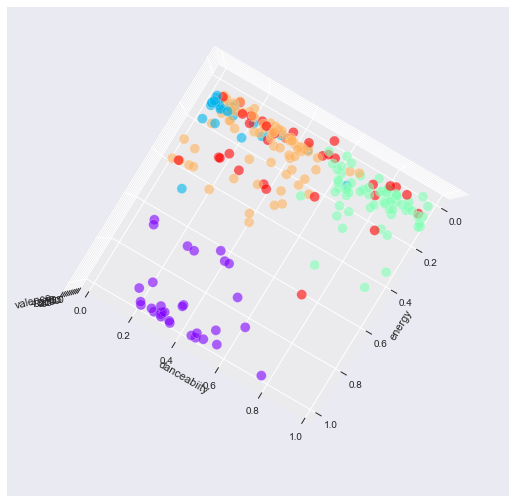

...

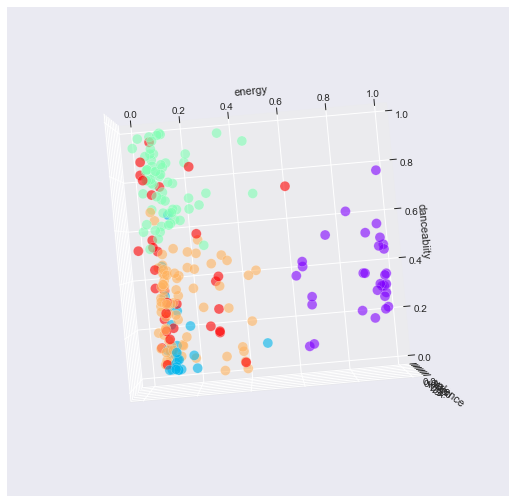

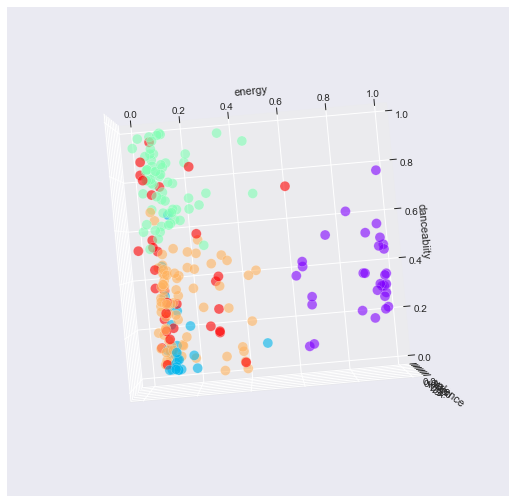

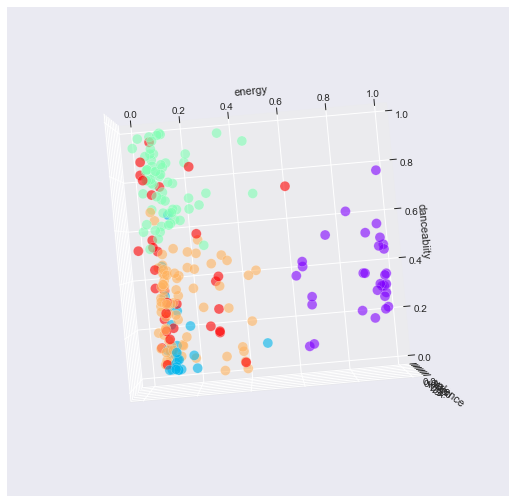

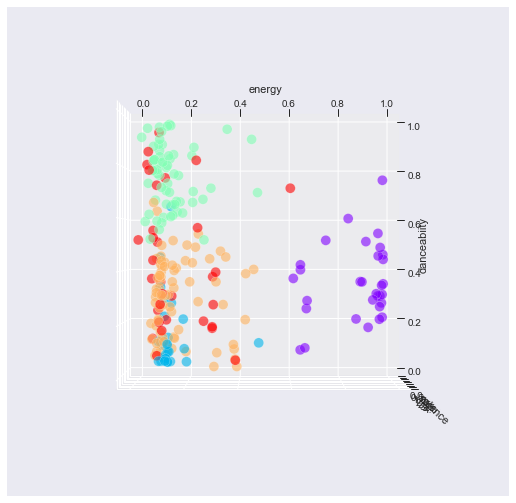

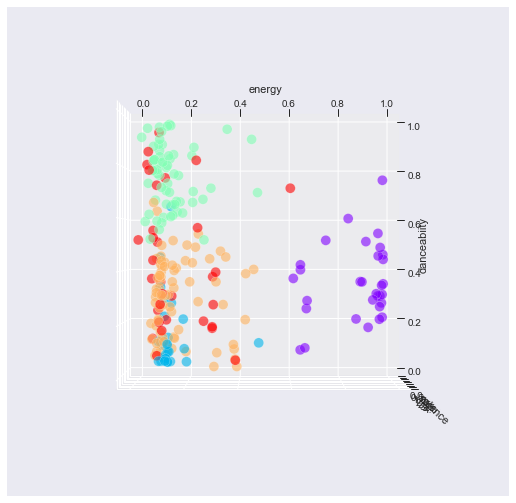

In [28]:
#Plotted against energy and danceability, our clusters appear more clearly. However, valence also 
#appears to have a quite high variance. Let´s to try to plot using 3D.

for angle in range(30,270,1):


    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    audio_3d = np.array((audiofeats).astype(float))

#

#kmeans = KMeans(n_clusters=4)  
#kmeans.fit(spot1)

    sns.set(rc={'figure.figsize':(9,9)})

    X = audio_3d[:,1]       #energy
    Y = audio_3d[:,5]       #danceability
    Z = audio_3d[:,6]       #valence

#ax.scatter(X, Y, Z, c='r', marker='o')
    ax.scatter(X, Y, Z, c=model.labels_, cmap='rainbow', marker='o',s=100, alpha=0.6, edgecolors='w')

    ax.set_xlabel('energy')
    ax.set_ylabel('danceabiity')
    ax.set_zlabel('valence')

    ax.view_init(90,angle)
    filename='3D Visualization/clustering_step'+str(angle)+'.png'
    plt.savefig(filename, dpi=72)

    plt.show()

# INTERPRETATION

In [29]:
#We merge the audiofeats dataset back with the non-interger type data containing track info.
#Let´s look at the songs that are clustered together.
#Only the first 10 songs of each clusters. 

audiofeats['cluster'] = model.labels_
audio_withinfo = audiofeats.merge(all_feats[['artist','song_names']], left_index=True, right_index=True)

audio_withinfo.head(10)
c1= audio_withinfo.loc[audiofeats['cluster'] == 0]
c2= audio_withinfo.loc[audiofeats['cluster'] == 1]
c3= audio_withinfo.loc[audiofeats['cluster'] == 2]
c4= audio_withinfo.loc[audiofeats['cluster'] == 3]
c5= audio_withinfo.loc[audiofeats['cluster'] == 4]


#ENERGY AVERAGES OF CLUSTERS.  

c_one_energy = (c1[['energy']].mean().energy)
c_two_energy = (c2[['energy']].mean().energy)
c_three_energy = (c3[['energy']].mean().energy)
c_four_energy = (c4[['energy']].mean().energy)
c_five_energy = (c5[['energy']].mean().energy)


c_one_liveness = (c1[['liveness']].mean().liveness)
c_two_liveness = (c2[['liveness']].mean().liveness)
c_three_liveness = (c3[['liveness']].mean().liveness)
c_four_liveness = (c4[['liveness']].mean().liveness)
c_five_liveness = (c5[['liveness']].mean().liveness)


c_one_speechiness = (c1[['speechiness']].mean().speechiness)
c_two_speechiness = (c2[['speechiness']].mean().speechiness)
c_three_speechiness = (c3[['speechiness']].mean().speechiness)
c_four_speechiness = (c4[['speechiness']].mean().speechiness)
c_five_speechiness = (c5[['speechiness']].mean().speechiness)


c_one_instrumentalness = (c1[['instrumentalness']].mean().instrumentalness)
c_two_instrumentalness = (c2[['instrumentalness']].mean().instrumentalness)
c_three_instrumentalness = (c3[['instrumentalness']].mean().instrumentalness)
c_four_instrumentalness = (c4[['instrumentalness']].mean().instrumentalness)
c_five_instrumentalness = (c5[['instrumentalness']].mean().instrumentalness)


c_one_danceability = (c1[['danceability']].mean().danceability)
c_two_danceability = (c2[['danceability']].mean().danceability)
c_three_danceability = (c3[['danceability']].mean().danceability)
c_four_danceability = (c4[['danceability']].mean().danceability)
c_five_danceability = (c5[['danceability']].mean().danceability)


all_means = {'energy': [c_one_energy, c_two_energy, c_three_energy, c_four_energy, c_five_energy], 
             'liveness': [c_one_liveness, c_two_liveness, c_three_liveness, c_four_liveness, c_five_liveness],     
             'speechiness': [c_one_speechiness, c_two_speechiness, c_three_speechiness, c_four_speechiness, c_five_speechiness],  
             'instrumentalness': [c_one_instrumentalness, c_two_instrumentalness, c_three_instrumentalness, c_four_instrumentalness, c_five_instrumentalness], 
             'danceability': [c_one_danceability, c_two_danceability, c_three_danceability, c_four_danceability, c_five_danceability], 
             'valence': [c_one_energy, c_two_energy, c_three_energy, c_four_energy, c_five_energy], 
}

all_means_df = pd.DataFrame(data=all_means)

print(all_means_df)

     energy  liveness  speechiness  instrumentalness  danceability   valence
0  0.743032  0.873903     0.091865          0.003895      0.453097  0.743032
1  0.127237  0.126448     0.042807          0.818963      0.247322  0.127237
2  0.701968  0.135198     0.076789          0.022943      0.708468  0.701968
3  0.550667  0.171248     0.071652          0.024886      0.572413  0.550667
4  0.689424  0.169048     0.060912          0.763727      0.651242  0.689424
